In [11]:
import SIMSIToolBox
import matplotlib.pyplot as plt
import os
import pandas as pd
import numpy as np
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from copy import deepcopy
import umap
from sklearn.cluster import KMeans
import pickle as pkl
import molmass
import SIMSIToolBox.recalibration
import importlib
importlib.reload(SIMSIToolBox)
import seaborn as sb

In [12]:
datadir = "X:/MSI_Shared_Data/13CImagingManuscript/raw_data/non-perfused/desi/13C/"

In [13]:
peaklist = pd.read_csv(datadir + "../30092022_desi_targets_annotated.csv")
peaklist

,datasetName,formula,adduct,chemMod,ion,mz,moleculeNames,moleculeIds,meanM0,clean,for_paper,ccs
0,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C32H36N4O5,M-H,NaN,C32H36N4O5-H-,555.261215,Quinidine barbiturate,HMDB0015436,0.999988,1,0,-1.0
1,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C33H36N2O6,M-H,NaN,C33H36N2O6-H-,555.249982,Dipiperamide C,HMDB0039457,0.999691,1,0,-1.0
2,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C14H28O2,M-H,NaN,C14H28O2-H-,227.201575,"12-Methyltridecanoic acid, Hexanal octane-1,3-...","HMDB0031072, HMDB0032318, HMDB0000806, HMDB000...",0.999609,1,0,-1.0
3,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C3H6O3,M-H,NaN,C3H6O3-H-,89.024339,"Monoethyl carbonate, Dimethyl carbonate, Dihyd...","HMDB0031232, HMDB0029580, HMDB0001882, HMDB000...",0.999546,1,0,-1.0
4,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C17H34O2,M-H,NaN,C17H34O2-H-,269.248525,"Nonyl octanoate, Heptadecanoic acid, (S)-14-Me...","HMDB0034131, HMDB0002259, HMDB0031067, HMDB003...",0.999047,1,0,-1.0
5,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C15H30O2,M-H,NaN,C15H30O2-H-,241.217225,"Dodecyl propionate, Hexyl nonanoate, Pentadeca...","HMDB0032250, HMDB0032328, HMDB0000826, HMDB003...",0.998841,1,0,-1.0
6,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C19H22O3,M-H,NaN,C19H22O3-H-,297.149540,"Gravelliferone, 5-Hydroxy-7-(4-hydroxyphenyl)-...","HMDB0030729, HMDB0033711, HMDB0034054, HMDB004...",0.997415,1,0,-1.0
7,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C21H26O3,M-H,NaN,C21H26O3-H-,325.180840,"Isoacitretin, Acitretin","HMDB0003039, HMDB0014602",0.996826,1,0,-1.0
8,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C16H32O2,M-H,NaN,C16H32O2-H-,255.232875,"Butyl dodecanoate, Dodecyl butyrate, Hexyl dec...","HMDB0032065, HMDB0032249, HMDB0032324, HMDB000...",0.995917,1,1,168.7
9,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C10H14N5O7P,M-H,NaN,C10H14N5O7P-H-,346.055729,"Adenosine monophosphate, 2'-Deoxyguanosine 5'-...","HMDB0000045, HMDB0001044, HMDB0003540, HMDB001...",0.994711,1,1,174.1


In [14]:
ppmThresh = 10
num_cores = 10
intensityCutoff = 0
convSquare = 3 #size of filter (1=1x1,3=3x3,5=5x5)
colormap = LinearSegmentedColormap.from_list("test",colors=["black", "navy","blue","cyan","yellow","orange","orangered","red","mistyrose","white"],N=256)
dm_method = "PCA" #method for dimensionality reduction ("PCA" or "TSNE") PCA has worked better for me
seg_method = "K_means" #thresholding method ("TIC_auto", "K_means", "TIC_manual")
num_components = 2 #number of compoents to use with PCA or TSNE
filtMethod = "GB" #filtering method (GB = gaussian blur, MA = moving average)

In [5]:
mzsCorr = list(peaklist["mz"].values)
mzsCorr.sort()

In [6]:
if __name__ == "__main__":
    tolerance = 0.10
    step = 0.002
    dalim = 0.05
    files = [x for x in os.listdir(datadir) if ".imzml" in x and "recal" not in x]
    for file in files:
        if file.replace(".imzml","_recal.imzML") not in os.listdir(datadir):
            print(file)
            SIMSIToolBox.recalibration.write_corrected_msi(datadir + file,datadir + file.replace(".imzml","_recal.imzML"),tolerance,mzsCorr,step,dalim,numCores=num_cores)



In [5]:
mzs = []
keys = []
for index,row in peaklist.iterrows():
    _,_,nC = SIMSIToolBox.getMzsOfIsotopologues(row["formula"],"C")
    for x in range(nC+1):
        mzs.append(row["mz"] + 1.00336 * x)
        keys.append((index,x))
print(len(mzs))

376


In [15]:
inds = []
for index,row in peaklist.iterrows():
    tmp = [x for x in range(len(keys)) if keys[x][0] == index]
    tmp.sort(key=lambda x: keys[x][1])
    inds.append(tmp)
peaklist["inds"] = inds
peaklist

,datasetName,formula,adduct,chemMod,ion,mz,moleculeNames,moleculeIds,meanM0,clean,for_paper,ccs,inds
0,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C32H36N4O5,M-H,NaN,C32H36N4O5-H-,555.261215,Quinidine barbiturate,HMDB0015436,0.999988,1,0,-1.0,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,..."
1,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C33H36N2O6,M-H,NaN,C33H36N2O6-H-,555.249982,Dipiperamide C,HMDB0039457,0.999691,1,0,-1.0,"[33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 4..."
2,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C14H28O2,M-H,NaN,C14H28O2-H-,227.201575,"12-Methyltridecanoic acid, Hexanal octane-1,3-...","HMDB0031072, HMDB0032318, HMDB0000806, HMDB000...",0.999609,1,0,-1.0,"[67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 7..."
3,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C3H6O3,M-H,NaN,C3H6O3-H-,89.024339,"Monoethyl carbonate, Dimethyl carbonate, Dihyd...","HMDB0031232, HMDB0029580, HMDB0001882, HMDB000...",0.999546,1,0,-1.0,"[82, 83, 84, 85]"
4,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C17H34O2,M-H,NaN,C17H34O2-H-,269.248525,"Nonyl octanoate, Heptadecanoic acid, (S)-14-Me...","HMDB0034131, HMDB0002259, HMDB0031067, HMDB003...",0.999047,1,0,-1.0,"[86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 9..."
5,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C15H30O2,M-H,NaN,C15H30O2-H-,241.217225,"Dodecyl propionate, Hexyl nonanoate, Pentadeca...","HMDB0032250, HMDB0032328, HMDB0000826, HMDB003...",0.998841,1,0,-1.0,"[104, 105, 106, 107, 108, 109, 110, 111, 112, ..."
6,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C19H22O3,M-H,NaN,C19H22O3-H-,297.149540,"Gravelliferone, 5-Hydroxy-7-(4-hydroxyphenyl)-...","HMDB0030729, HMDB0033711, HMDB0034054, HMDB004...",0.997415,1,0,-1.0,"[120, 121, 122, 123, 124, 125, 126, 127, 128, ..."
7,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C21H26O3,M-H,NaN,C21H26O3-H-,325.180840,"Isoacitretin, Acitretin","HMDB0003039, HMDB0014602",0.996826,1,0,-1.0,"[140, 141, 142, 143, 144, 145, 146, 147, 148, ..."
8,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C16H32O2,M-H,NaN,C16H32O2-H-,255.232875,"Butyl dodecanoate, Dodecyl butyrate, Hexyl dec...","HMDB0032065, HMDB0032249, HMDB0032324, HMDB000...",0.995917,1,1,168.7,"[162, 163, 164, 165, 166, 167, 168, 169, 170, ..."
9,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C10H14N5O7P,M-H,NaN,C10H14N5O7P-H-,346.055729,"Adenosine monophosphate, 2'-Deoxyguanosine 5'-...","HMDB0000045, HMDB0001044, HMDB0003540, HMDB001...",0.994711,1,1,174.1,"[179, 180, 181, 182, 183, 184, 185, 186, 187, ..."


In [9]:
msis = {}

extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 
extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 
extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 
extracting intensities

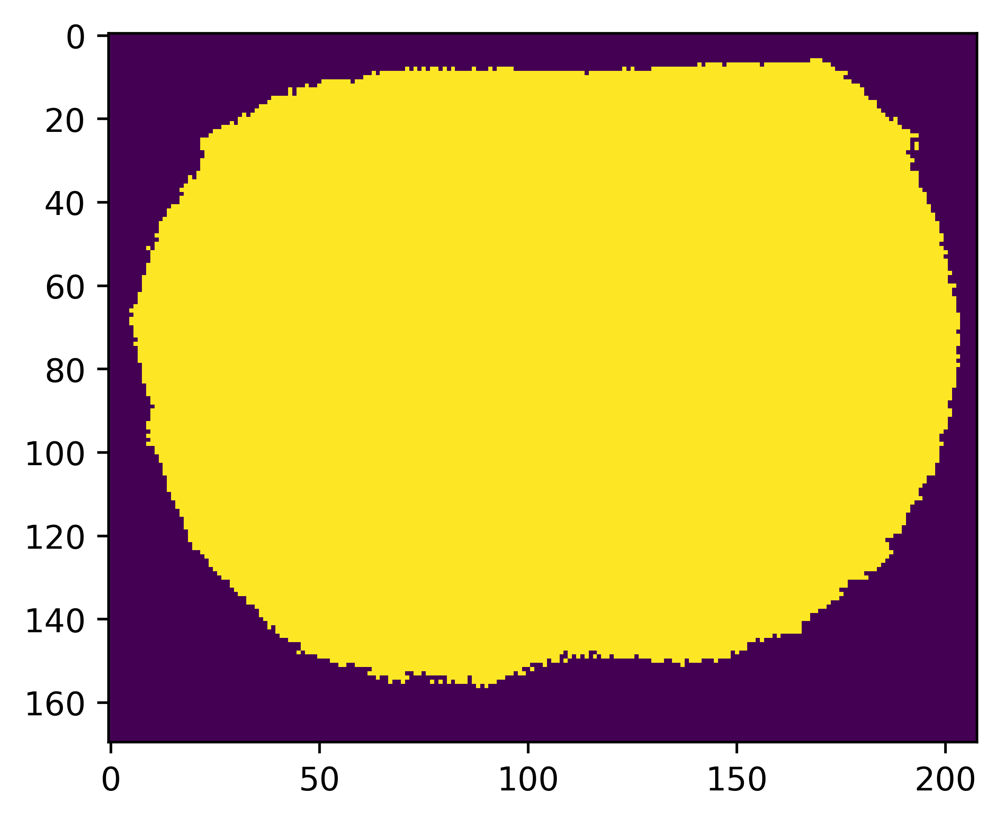

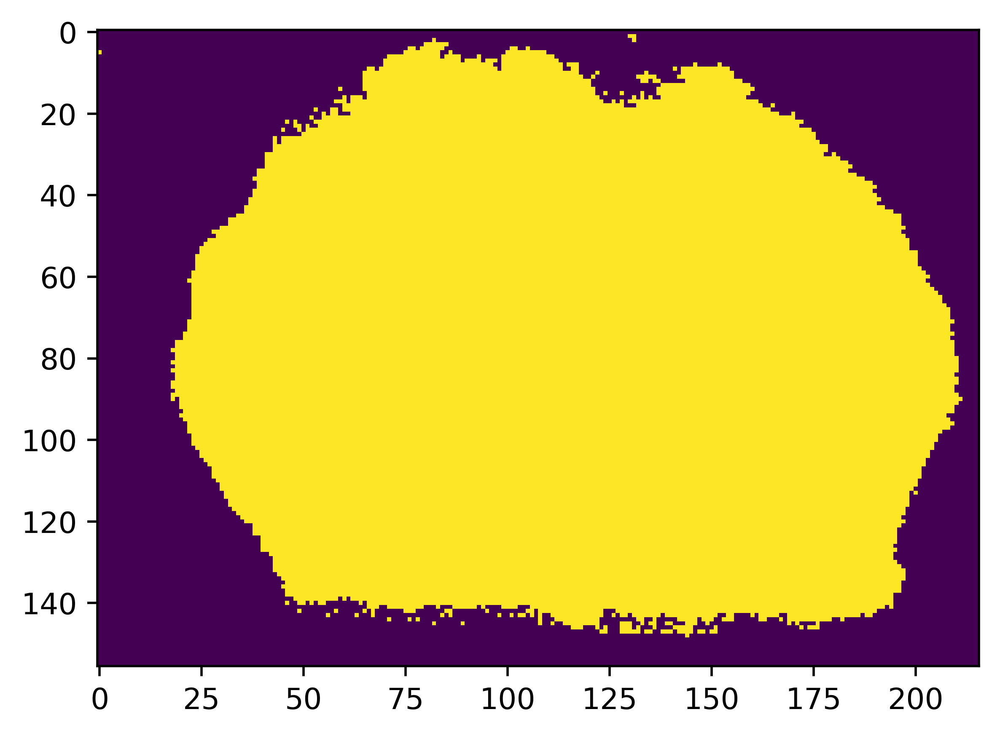

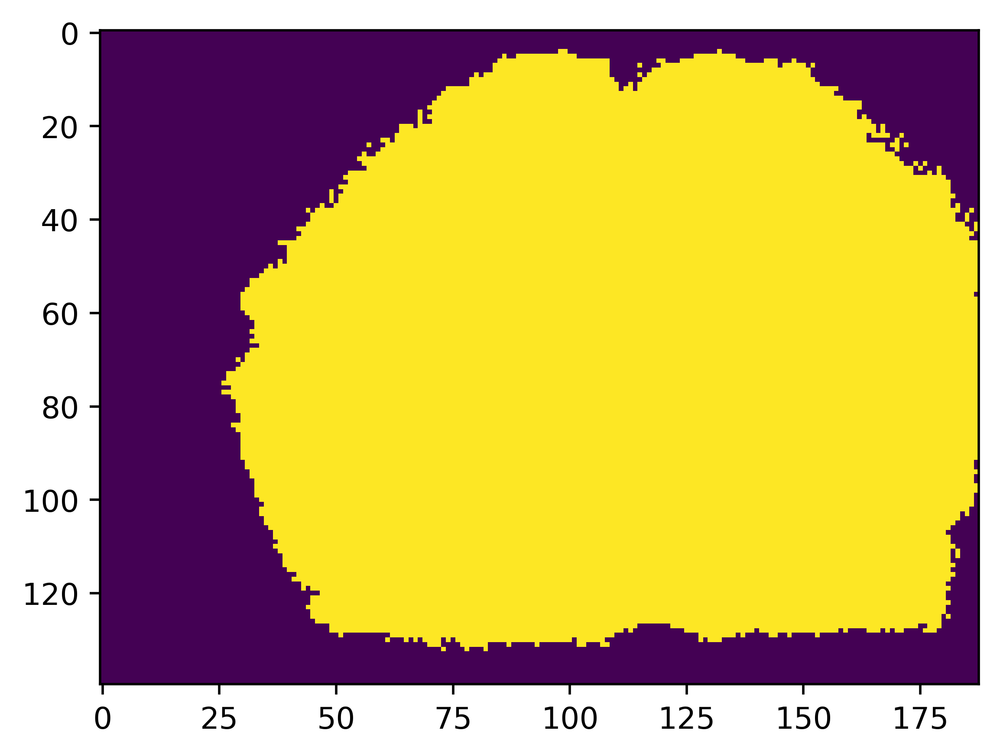

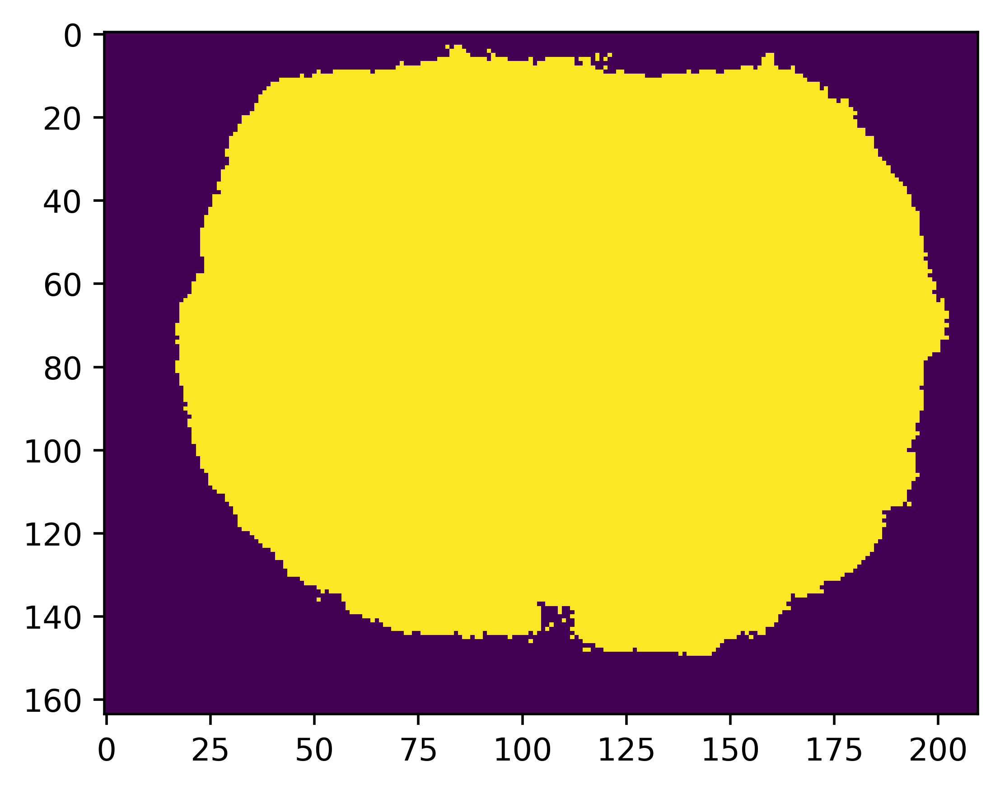

In [10]:
if __name__ == "__main__":
    files = [x for x in os.listdir(datadir) if "_recal.imzML" in x]
    for file in files:
        if file not in msis:
            msi = SIMSIToolBox.MSIData(mzs,ppm=ppmThresh,numCores = num_cores,intensityCutoff=intensityCutoff)
            msi.readimzML(datadir + file)
            msi.segmentImage(method=seg_method, num_latent=num_components, dm_method=dm_method,fill_holes = True)
            plt.close()
            plt.figure()
            plt.imshow(msi.imageBoundary)
            msi.smoothData(filtMethod,convSquare)
            msi.correctNaturalAbundance(peaklist["formula"].values,peaklist["inds"].values)
            msis[file] = msi



In [ ]:
#resegment
#if __name__ == "__main__":
#    file = "20221104_mt_tumor_brain4-3_13E_13C_20um_70-560mz Analyte 2_1_recal.imzML"
#    msi = SIMSIToolBox.MSIData(mzs,ppm=ppmThresh,numCores = num_cores,intensityCutoff=intensityCutoff)
#    msi.readimzML(datadir + file)
#    msi.segmentImage(method="TIC_manual",fill_holes = True,threshold=0.41e6)
#    plt.figure()
#    plt.imshow(msi.imageBoundary)
#    msi.smoothData(filtMethod,convSquare)
#    msi.correctNaturalAbundance(peaklist["formula"].values,peaklist["inds"].values)
#    msis[file] = msi



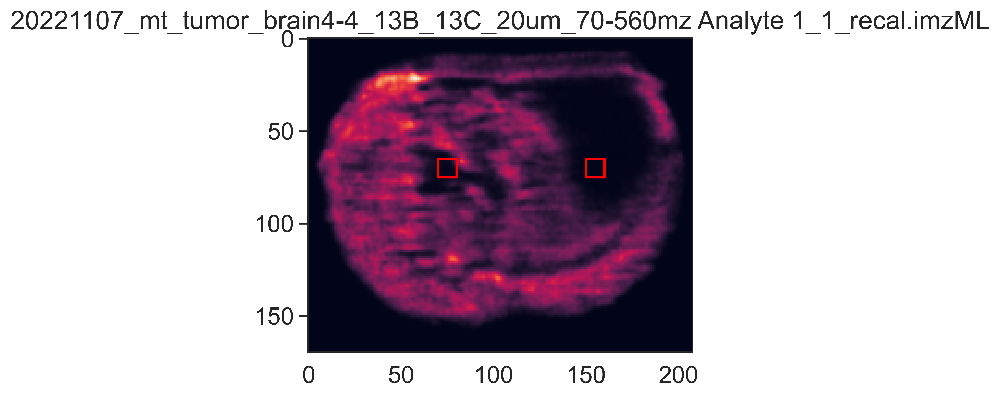

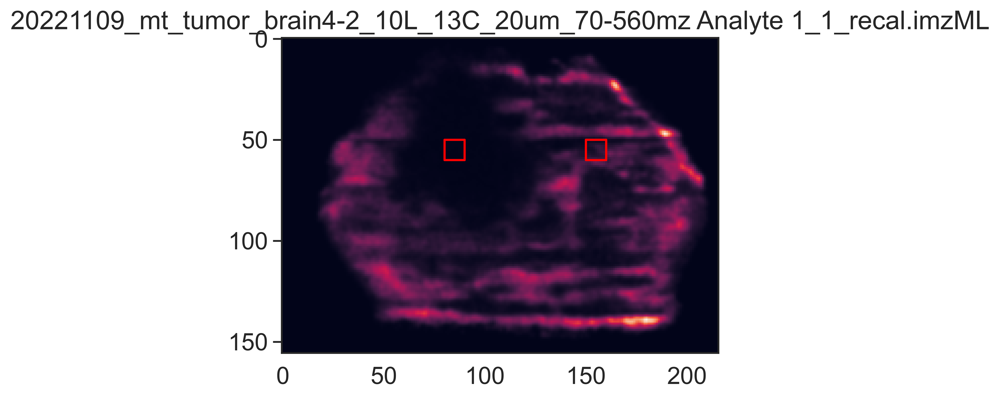

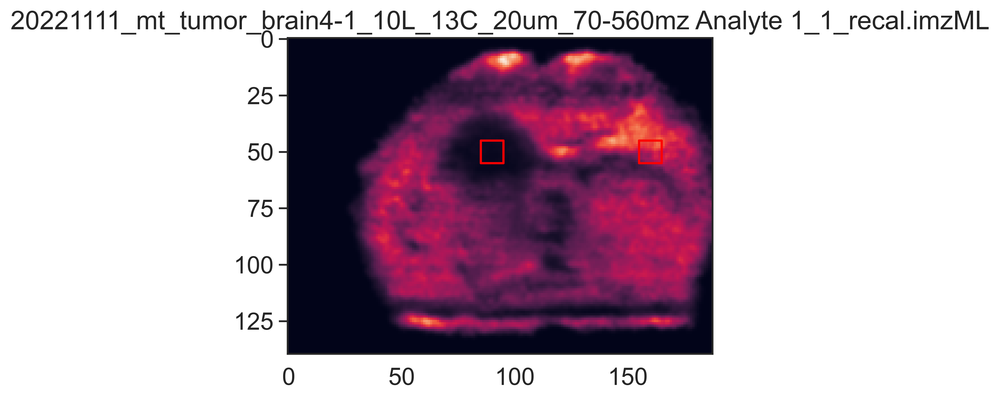

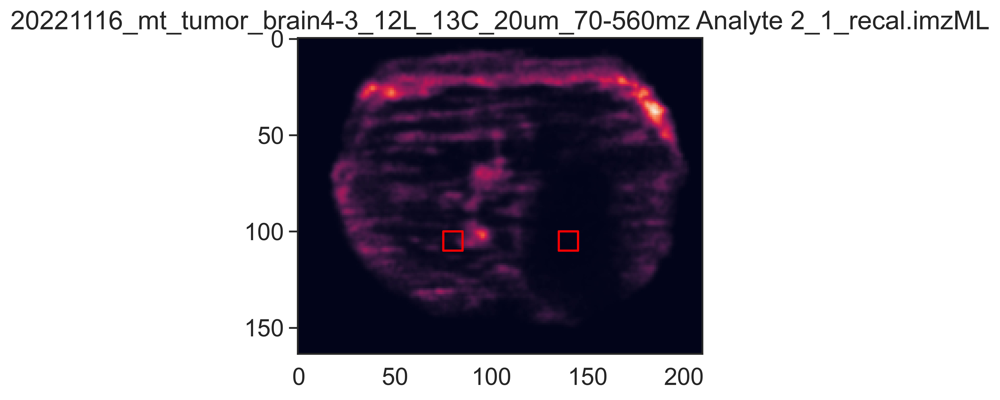

In [16]:
boxSize = 10
boxBoundaries = {'20221026_mt_tumor_brain4-1_11E_13C_10um_70-560mz Analyte 1_1_recal.imzML':{"i":[[60,60+boxSize],[45,45+boxSize]],"c":[[120,120+boxSize],[45,45+boxSize]]},
                        '20221028_mt_tumor_brain4-2_12B_13C_10um_70-560mz Analyte 1_1_recal.imzML':{"i":[[75,75+boxSize],[60,60+boxSize]],"c":[[140,140+boxSize],[60,60+boxSize]]},
                        "20221031_mt_tumor_brain4-4_13D_13C_10um_70-560mz Analyte 1_1_recal.imzML":{"i":[[160,160+boxSize],[70,70+boxSize]],"c":[[60,60+boxSize],[70,70+boxSize]]},
                        "20221102_mt_tumor_brain4-3_13D_13C_10um_70-560mz Analyte 1_1_recal.imzML":{"i":[[140,140+boxSize],[110,110+boxSize]],"c":[[50,50+boxSize],[110,110+boxSize]]},
                         "20221104_mt_tumor_brain4-3_13E_13C_20um_70-560mz Analyte 2_1_recal.imzML":{"i":[[150,150+boxSize],[90,90+boxSize]],"c":[[70,70+boxSize],[90,90+boxSize]]},
                         "20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML":{"i":[[150,150+boxSize],[65,65+boxSize]],"c":[[70,70+boxSize],[65,65+boxSize]]},             
                         "20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML":{"i":[[80,80+boxSize],[50,50+boxSize]],"c":[[150,150+boxSize],[50,50+boxSize]]},
                         "20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML":{"i":[[85,85+boxSize],[45,45+boxSize]],"c":[[155,155+boxSize],[45,45+boxSize]]},
                         "20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML":{"i":[[135,135+boxSize],[100,100+boxSize]],"c":[[75,75+boxSize],[100,100+boxSize]]}
                }
naaInds = [369, 370, 371, 372, 373, 374, 375]
def plotBox(xmin,xmax,ymin,ymax,color):
    plt.plot([xmin,xmax],[ymin,ymin],color)
    plt.plot([xmin,xmax],[ymax,ymax],color)
    plt.plot([xmin,xmin],[ymin,ymax],color)
    plt.plot([xmax,xmax],[ymin,ymax],color)
    
def addBox(xmin,xmax,ymin,ymax,color,image):
    image = deepcopy(image)
    image[xmin:xmax+1,ymin] = color
    image[xmin:xmax+1,ymax] = color
    image[xmin,ymin:ymax+1] = color
    image[xmax,ymin:ymax+1] = color
    return image

for fn in msis:
    plt.figure()
    plt.imshow(msis[fn].data_tensor[naaInds,:,:].sum(axis=0))
    plt.title(fn)    

    box1 = boxBoundaries[fn]["i"]
    box2 = boxBoundaries[fn]["c"]

    plotBox(*box1[0],*box1[1],"red")
    plotBox(*box2[0],*box2[1],"red")


In [17]:
molsOfInterest = ["C16H32O2","C18H36O2"]

In [18]:
def getMeanValueFromBox(arr,xmin,xmax,ymin,ymax):
    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(arr[x,y])
    roi = np.array(roi)
    return np.mean(roi)

Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 


,palmitate_g,palmitate_x0,palmitate_x1,palmitate_x2,palmitate_g_lh,palmitate_x0_lh,palmitate_x1_lh,palmitate_x2_lh,palmitate_g_rh,palmitate_x0_rh,...,stearate_g_lh,stearate_e_lh,stearate_x0_lh,stearate_x1_lh,stearate_x2_lh,stearate_g_rh,stearate_e_rh,stearate_x0_rh,stearate_x1_rh,stearate_x2_rh
20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML,0.150892,0.339596,0.081706,0.578698,0.216212,0.367667,0.082089,0.550244,0.142353,0.283813,...,0.156946,0.081219,0.380301,0.115510,0.504189,0.058894,0.061152,0.304337,0.095568,0.600095
20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML,0.136130,0.378565,0.082586,0.538712,0.201663,0.366766,0.087954,0.545280,0.094541,0.343141,...,0.119571,0.107296,0.436816,0.112726,0.450458,0.033118,0.055925,0.278612,0.279582,0.441806
20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML,0.127027,0.355443,0.076736,0.567820,0.181051,0.362868,0.078910,0.558222,0.111922,0.335800,...,0.086921,0.065857,0.354753,0.150608,0.494639,0.040268,0.053638,0.307906,0.118542,0.573552
20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML,0.116959,0.314814,0.079765,0.605284,0.191776,0.343837,0.083039,0.573124,0.059743,0.324117,...,0.100326,0.069885,0.375784,0.093908,0.530307,0.021085,0.031477,0.262079,0.301698,0.436224


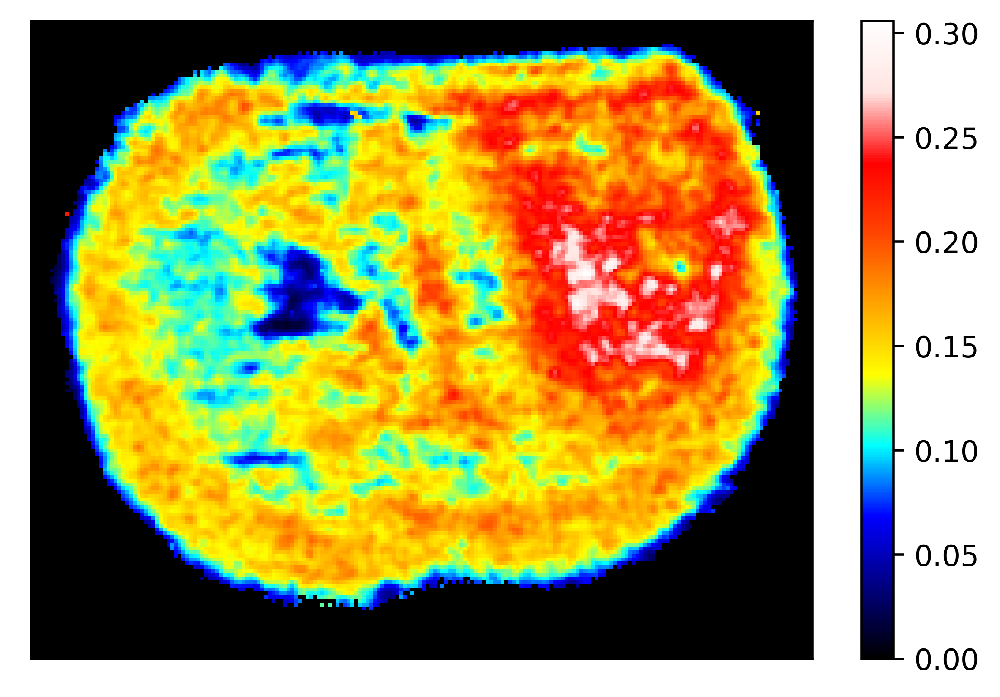

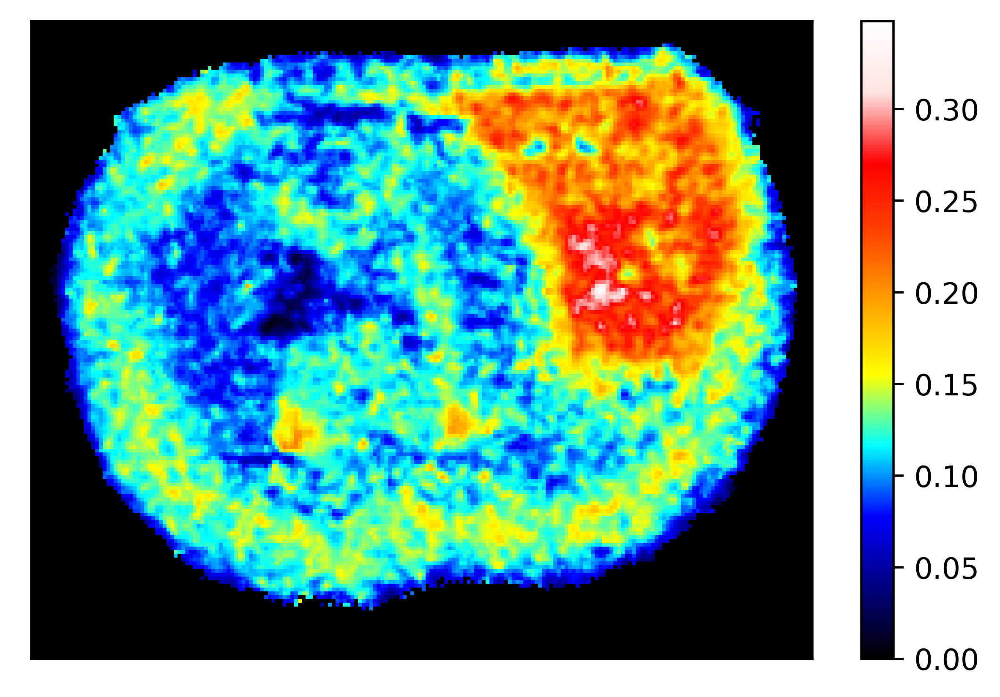

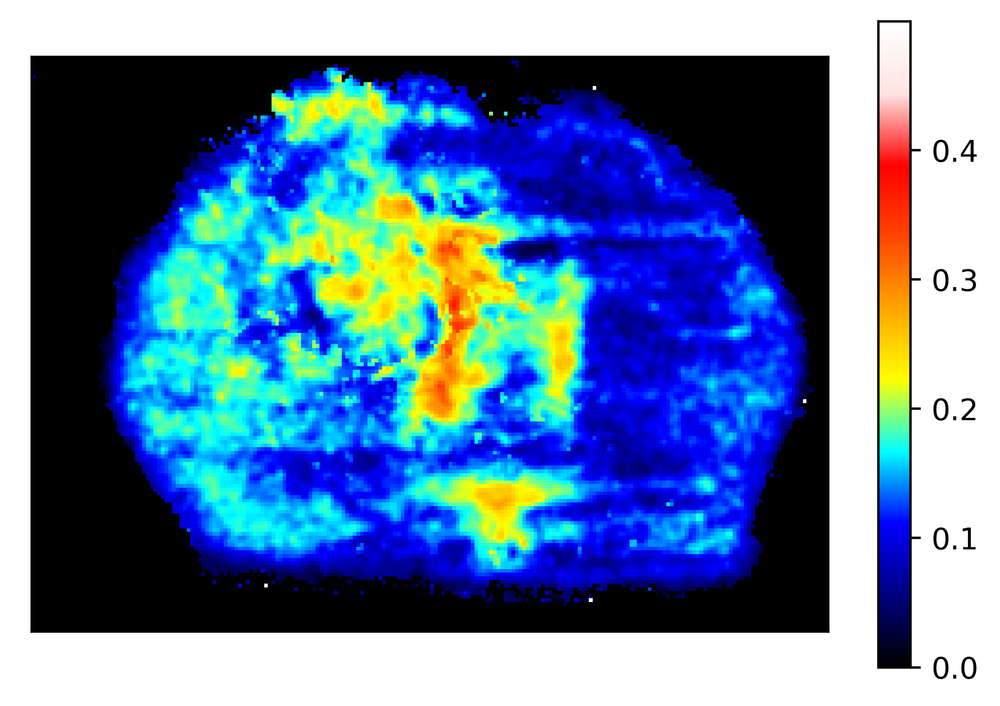

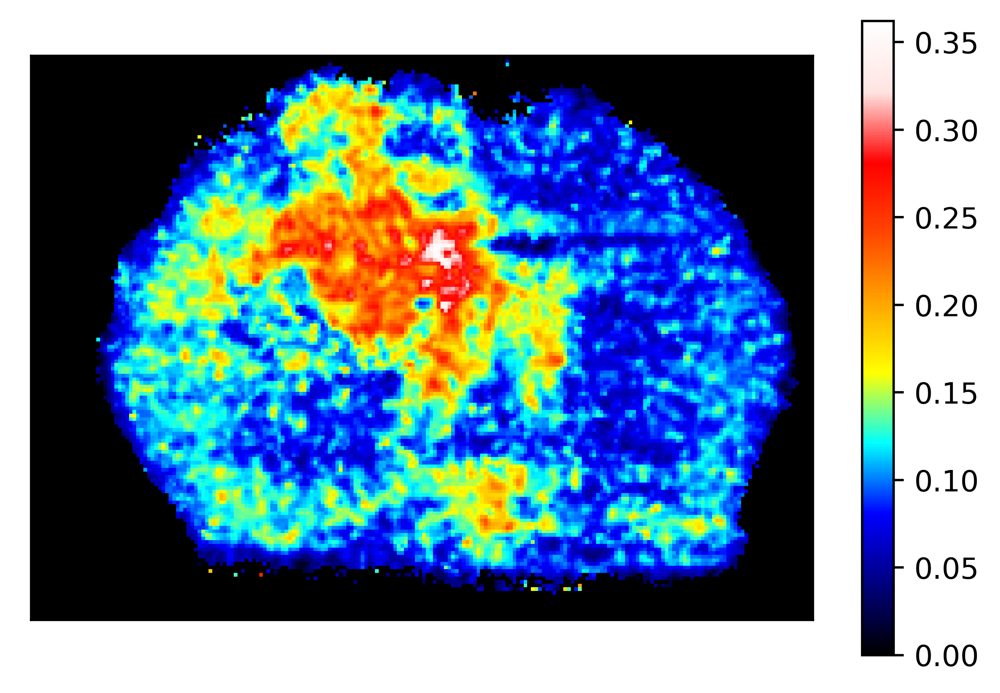

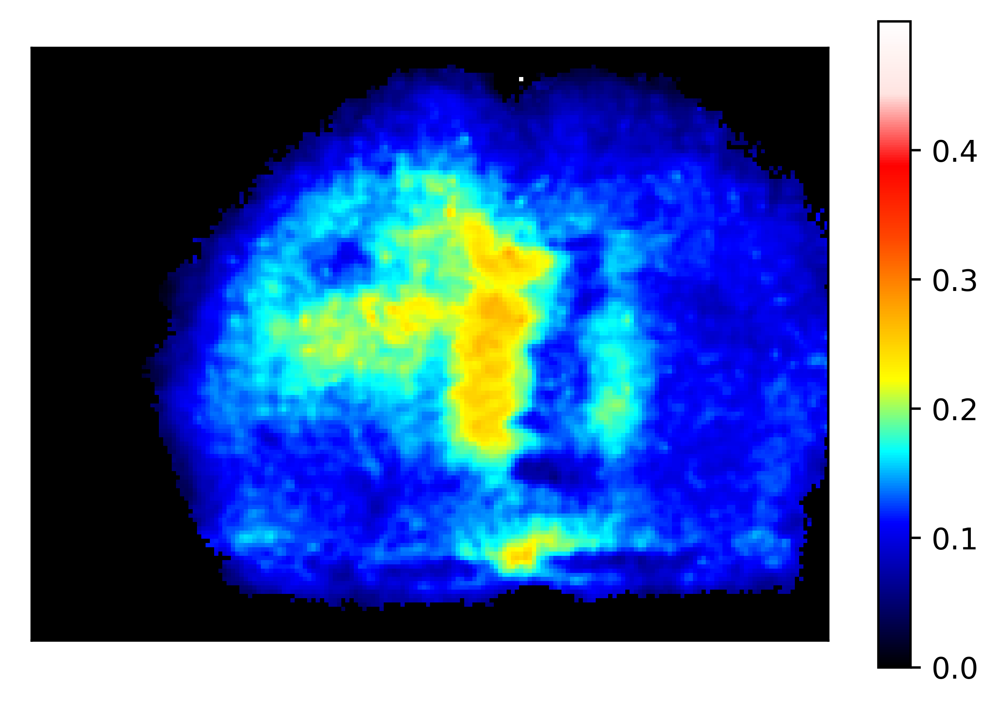

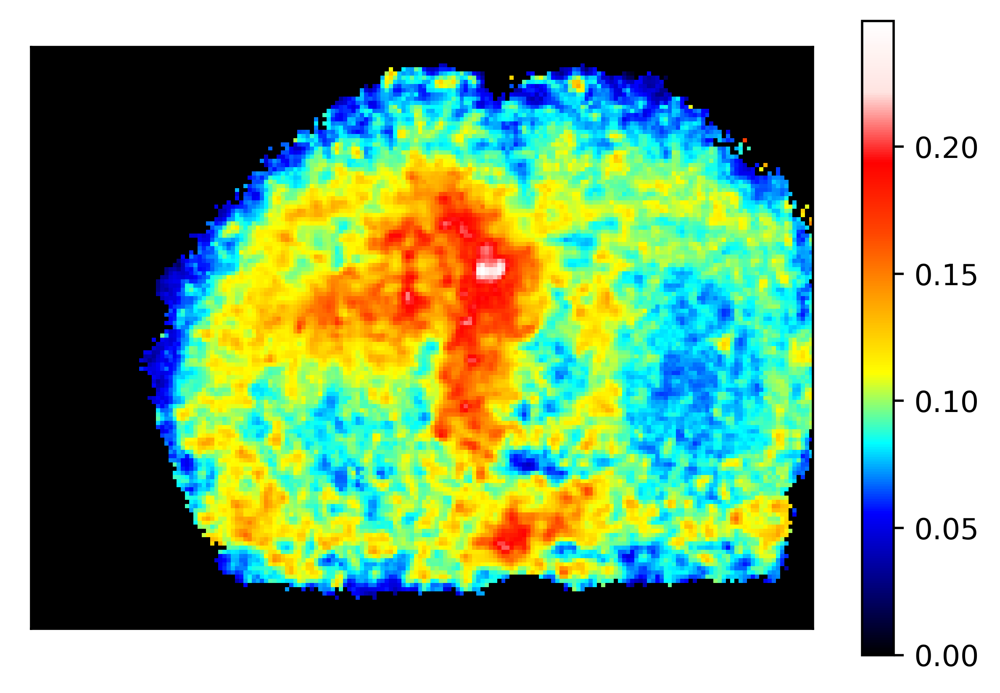

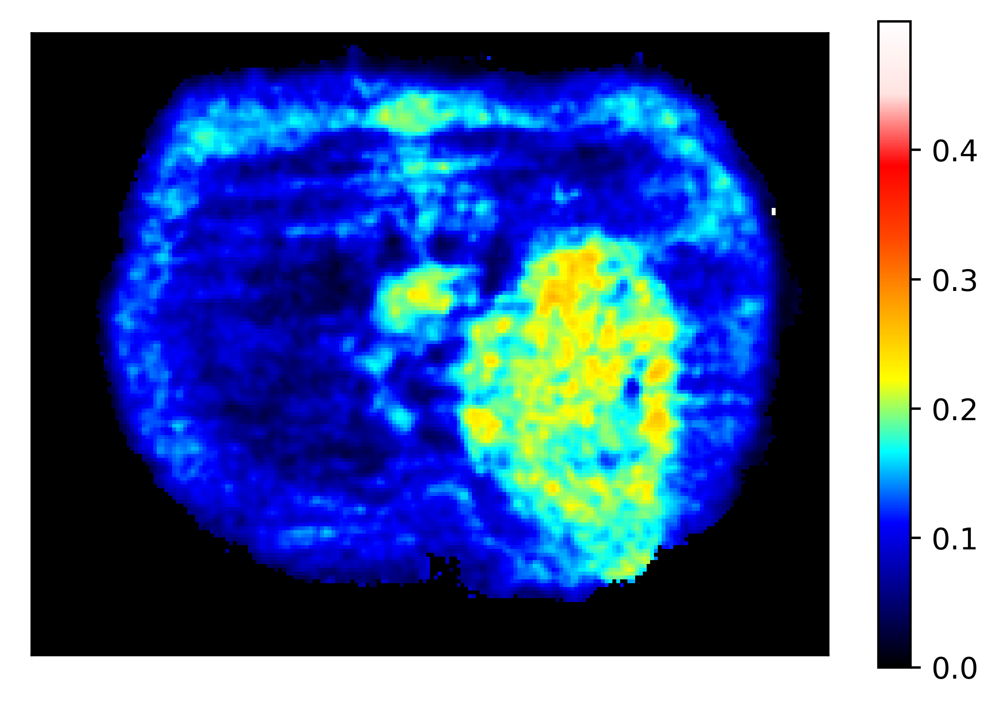

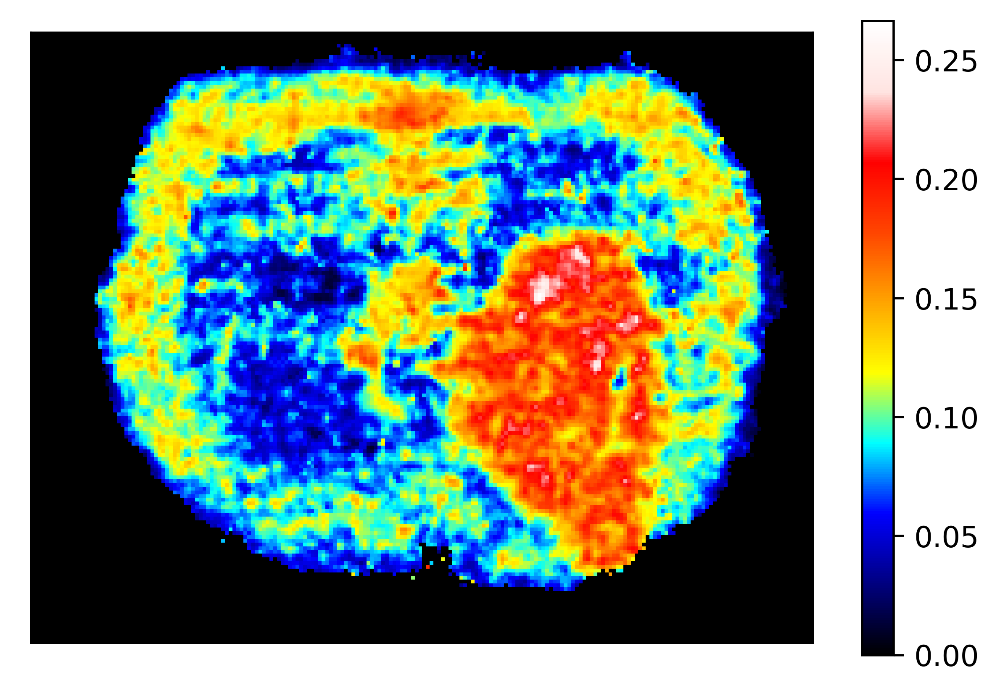

In [17]:
for fn in msis:
    try: os.mkdir(datadir + fn.replace(".imzML",""))
    except: pass
    
badIndsPal = [1,4,5]
badIndsSt = [17]

peaklistFilt = peaklist[peaklist["formula"].isin(molsOfInterest)]
peaklistFilt = peaklistFilt.sort_values(by="mz",ascending=True)

fluxImages = {}
meanFluxes = {}

if __name__ == "__main__":
    for fn in msis:
        fluxImages[fn] = {}
        meanFluxes[fn] = {}

        palmInd = peaklistFilt.index.values[0]
        stInd = peaklistFilt.index.values[1]

        shape = msis[fn].tic_image.shape
        
        origTensor = deepcopy(msis[fn].data_tensor)

        msis[fn].data_tensor[np.array(peaklistFilt.at[palmInd,"inds"])[badIndsPal]] = np.zeros((len(badIndsPal),shape[0],shape[1]))
        msis[fn].data_tensor[np.array(peaklistFilt.at[stInd,"inds"])[badIndsSt]] = np.zeros((len(badIndsSt),shape[0],shape[1]))

        fluxImageG,fluxImageE,fluxImageD,fluxImageT0,fluxImageT1,fluxImageT2,T_founds,P_trues,P_preds,numFounds,errs,errors = msis[fn].runISA(inds=peaklistFilt.at[palmInd,"inds"],minIso=0,minFrac=0.0,NACorrected=True,)            
        plt.figure()
        SIMSIToolBox.showImage(fluxImageG,cmap=colormap) 
        
        box1 = boxBoundaries[fn]["i"]
        box2 = boxBoundaries[fn]["c"]
        
        
        meanFluxes[fn]["palmitate_g"] = np.mean(fluxImageG[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["palmitate_x0"] = np.mean(fluxImageT0[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["palmitate_x1"] = np.mean(fluxImageT1[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["palmitate_x2"] = np.mean(fluxImageT2[msis[fn].imageBoundary > 0.5])

        meanFluxes[fn]["palmitate_g_lh"] = getMeanValueFromBox(fluxImageG,*box1[1],*box1[0])
        meanFluxes[fn]["palmitate_x0_lh"] = getMeanValueFromBox(fluxImageT0,*box1[1],*box1[0])
        meanFluxes[fn]["palmitate_x1_lh"] = getMeanValueFromBox(fluxImageT1,*box1[1],*box1[0])
        meanFluxes[fn]["palmitate_x2_lh"] = getMeanValueFromBox(fluxImageT2,*box1[1],*box1[0])

        meanFluxes[fn]["palmitate_g_rh"] = getMeanValueFromBox(fluxImageG,*box2[1],*box2[0])
        meanFluxes[fn]["palmitate_x0_rh"] = getMeanValueFromBox(fluxImageT0,*box2[1],*box2[0])
        meanFluxes[fn]["palmitate_x1_rh"] = getMeanValueFromBox(fluxImageT1,*box2[1],*box2[0])
        meanFluxes[fn]["palmitate_x2_rh"] = getMeanValueFromBox(fluxImageT2,*box2[1],*box2[0])

        fluxImages[fn]["palmitate"] = {"g":fluxImageG,"e":fluxImageE,"d":fluxImageD,"x0":fluxImageT0,"x1":fluxImageT1,"x2":fluxImageT2,"errs":errs}

        fluxImageST,fluxImageE,fluxImageD,fluxImageT0,fluxImageT1,fluxImageT2,T_founds,P_trues,P_preds,numFounds,errs,errors = msis[fn].runISA(isaModel="elongation",inds=peaklistFilt.at[stInd,"inds"],minIso=0,minFrac=0.00,NACorrected=True)
        fluxImages[fn]["stearate"] = {"g":fluxImageST,"e":fluxImageE,"g+e":fluxImageST+fluxImageE,"d":fluxImageD,"x0":fluxImageT0,"x1":fluxImageT1,"x2":fluxImageT2,"errs":errs}

        plt.figure()
        SIMSIToolBox.showImage(fluxImageST + fluxImageE,cmap=colormap)
        
        meanFluxes[fn]["stearate_g"] = np.mean(fluxImageST[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["stearate_e"] = np.mean(fluxImageE[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["stearate_x0"] = np.mean(fluxImageT0[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["stearate_x1"] = np.mean(fluxImageT1[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["stearate_x2"] = np.mean(fluxImageT2[msis[fn].imageBoundary > 0.5])

        meanFluxes[fn]["stearate_g_lh"] = getMeanValueFromBox(fluxImageST,*box1[1],*box1[0])
        meanFluxes[fn]["stearate_e_lh"] = getMeanValueFromBox(fluxImageE,*box1[1],*box1[0])
        meanFluxes[fn]["stearate_x0_lh"] = getMeanValueFromBox(fluxImageT0,*box1[1],*box1[0])
        meanFluxes[fn]["stearate_x1_lh"] = getMeanValueFromBox(fluxImageT1,*box1[1],*box1[0])
        meanFluxes[fn]["stearate_x2_lh"] = getMeanValueFromBox(fluxImageT2,*box1[1],*box1[0])

        meanFluxes[fn]["stearate_g_rh"] = getMeanValueFromBox(fluxImageST,*box2[1],*box2[0])
        meanFluxes[fn]["stearate_e_rh"] = getMeanValueFromBox(fluxImageE,*box2[1],*box2[0])
        meanFluxes[fn]["stearate_x0_rh"] = getMeanValueFromBox(fluxImageT0,*box2[1],*box2[0])
        meanFluxes[fn]["stearate_x1_rh"] = getMeanValueFromBox(fluxImageT1,*box2[1],*box2[0])
        meanFluxes[fn]["stearate_x2_rh"] = getMeanValueFromBox(fluxImageT2,*box2[1],*box2[0])

        msis[fn].data_tensor = origTensor

    meanFluxes = pd.DataFrame.from_dict(meanFluxes,orient="index")
meanFluxes

In [18]:
meanFluxes.to_csv(datadir + "average_fluxes.csv")

c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


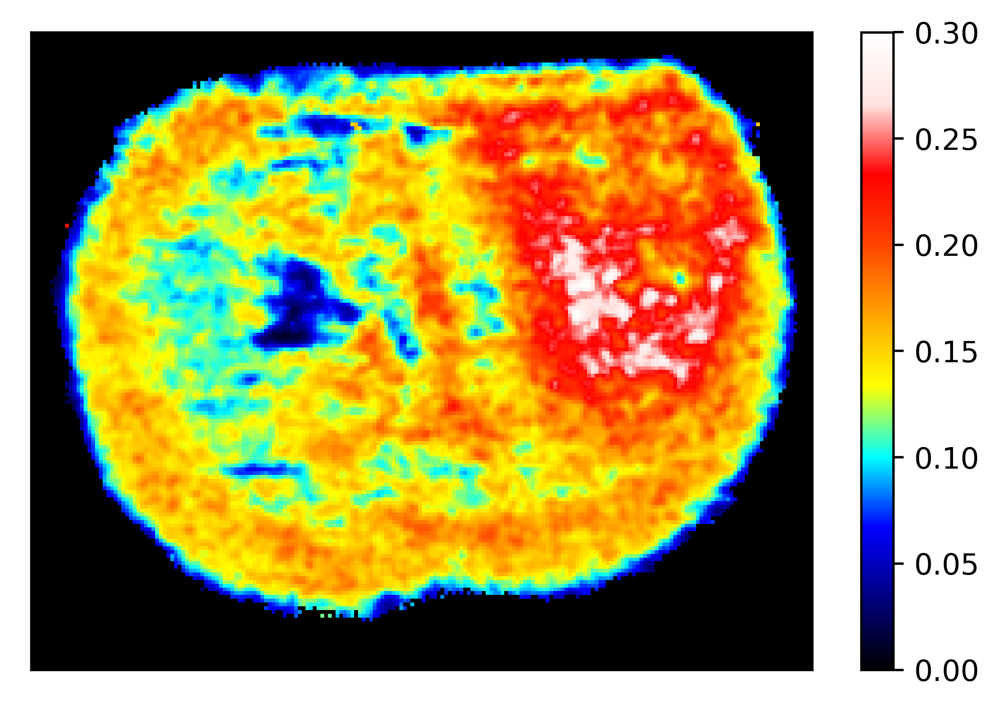

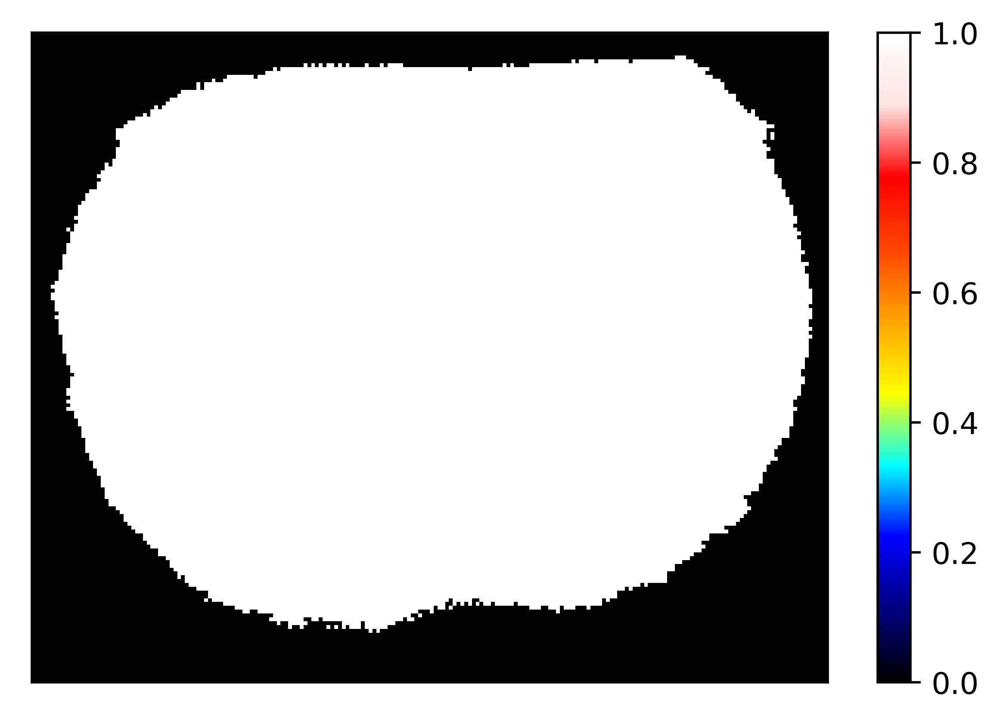

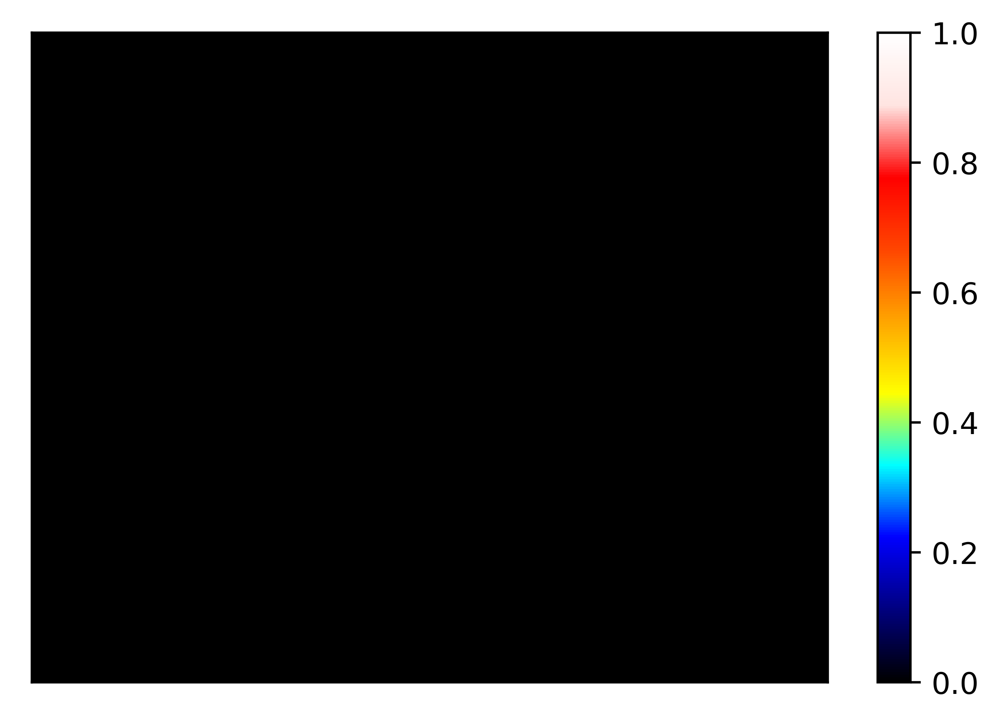

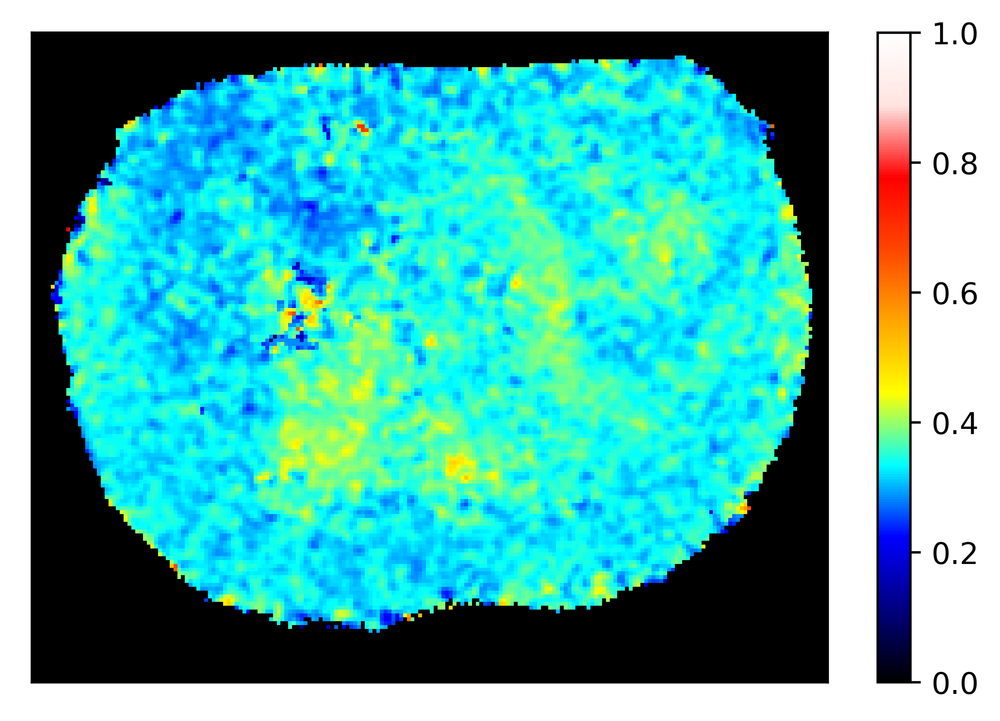

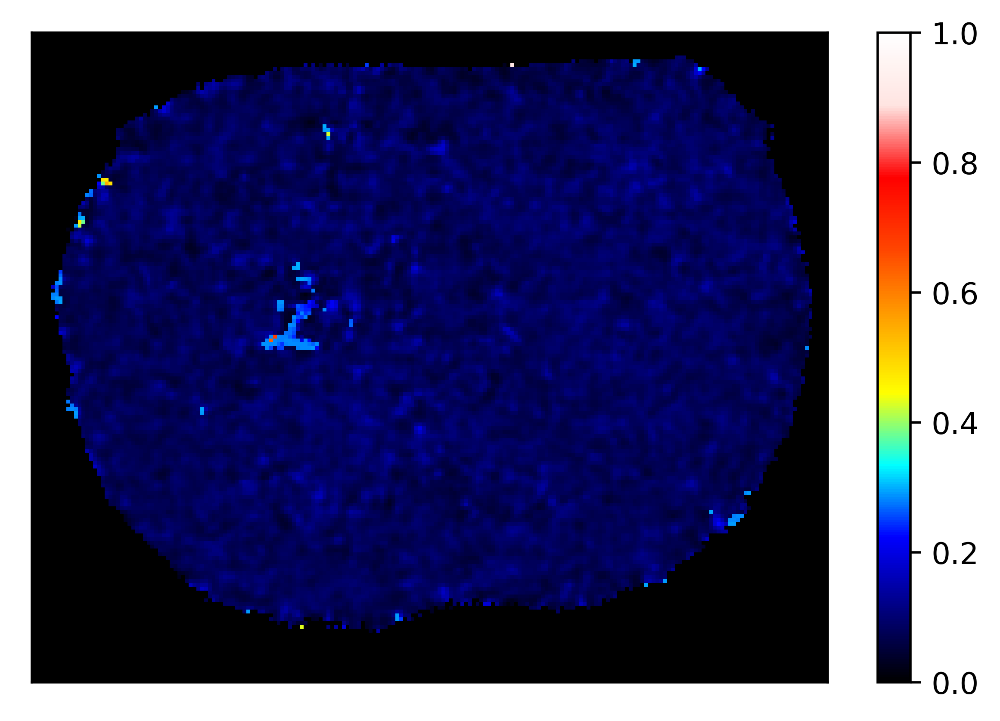

...

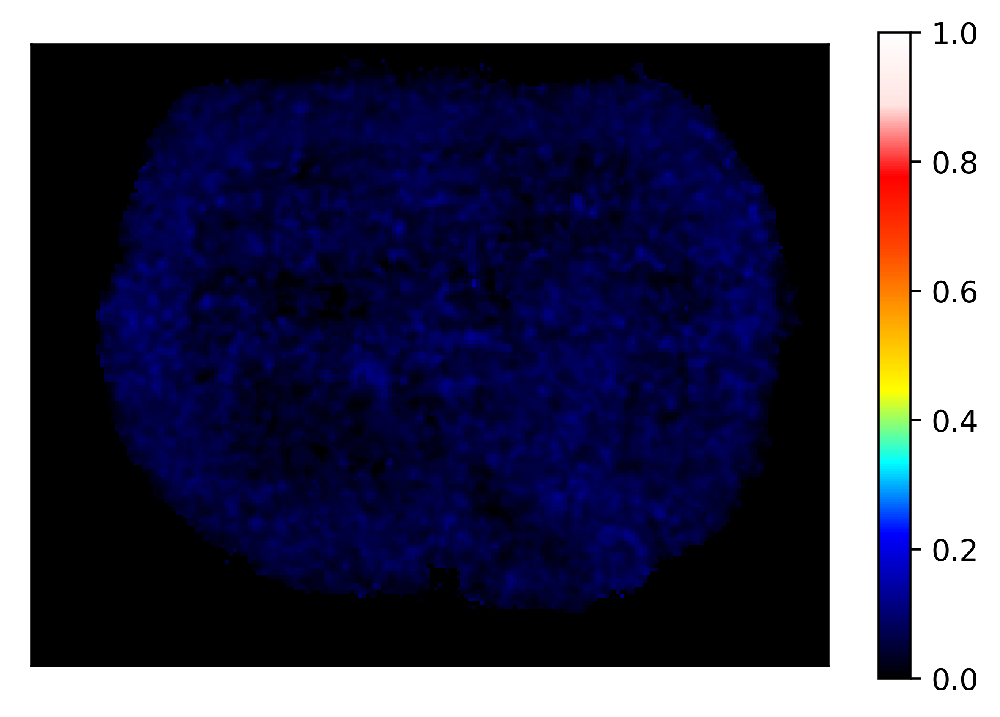

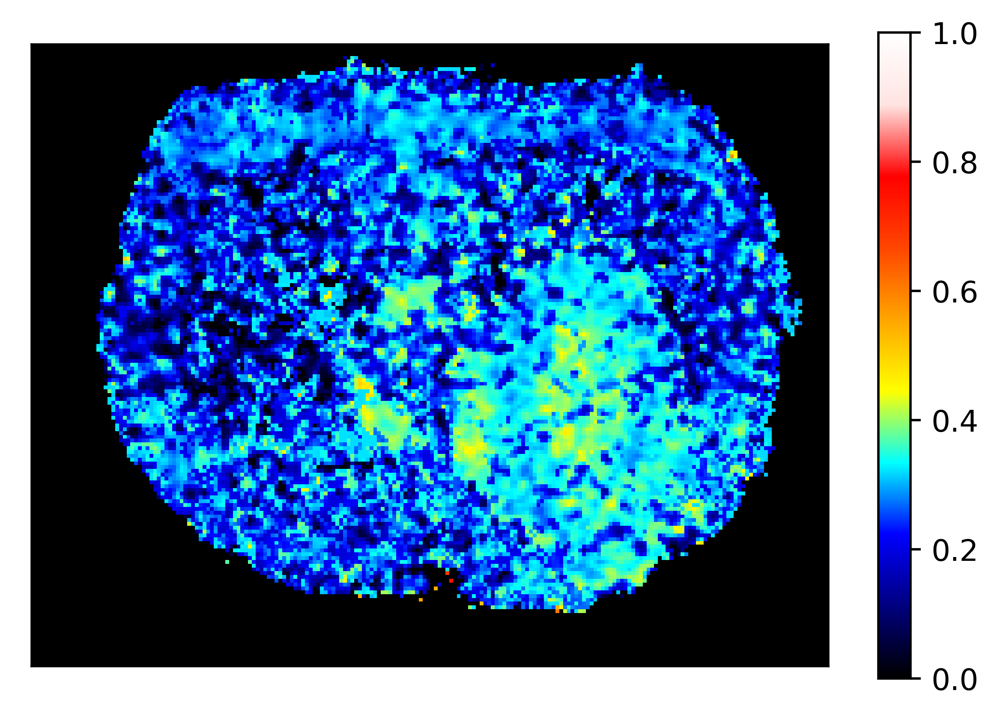

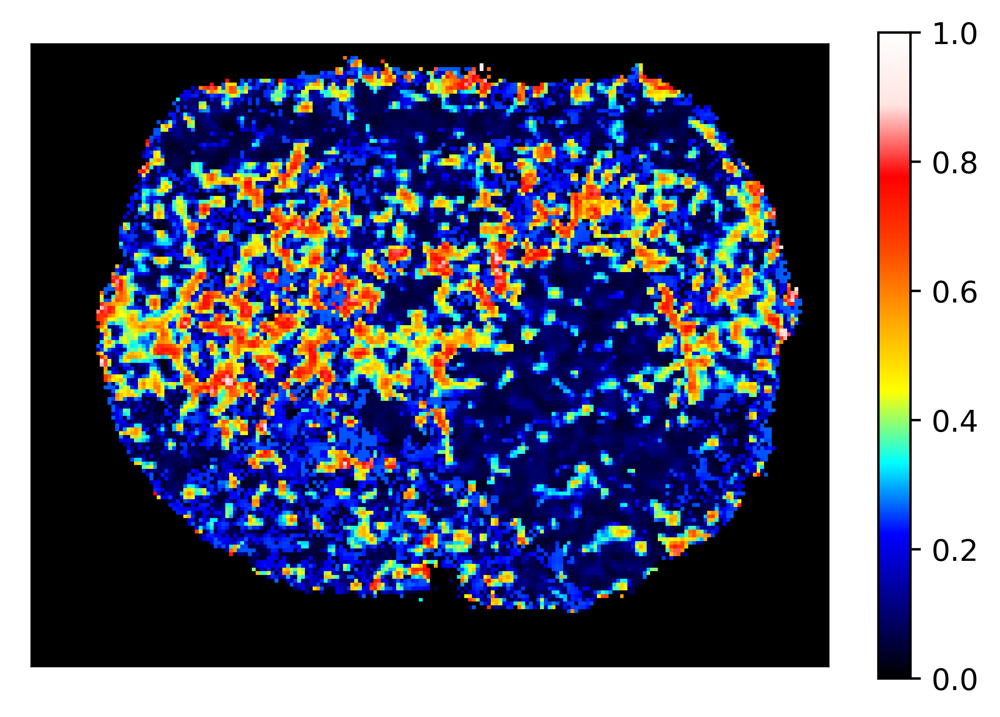

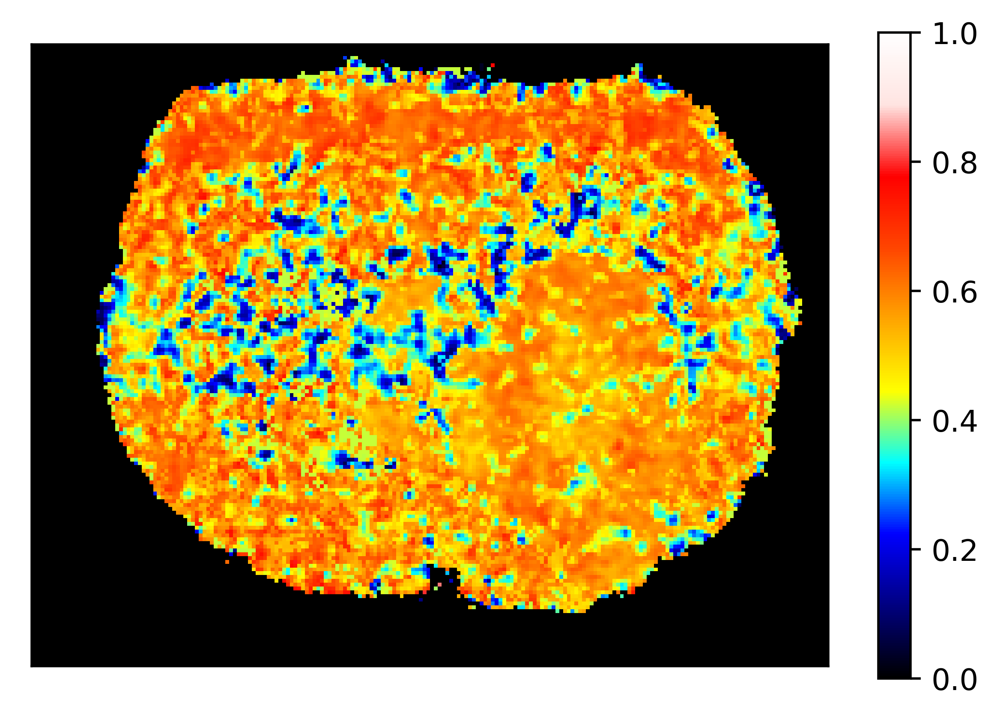

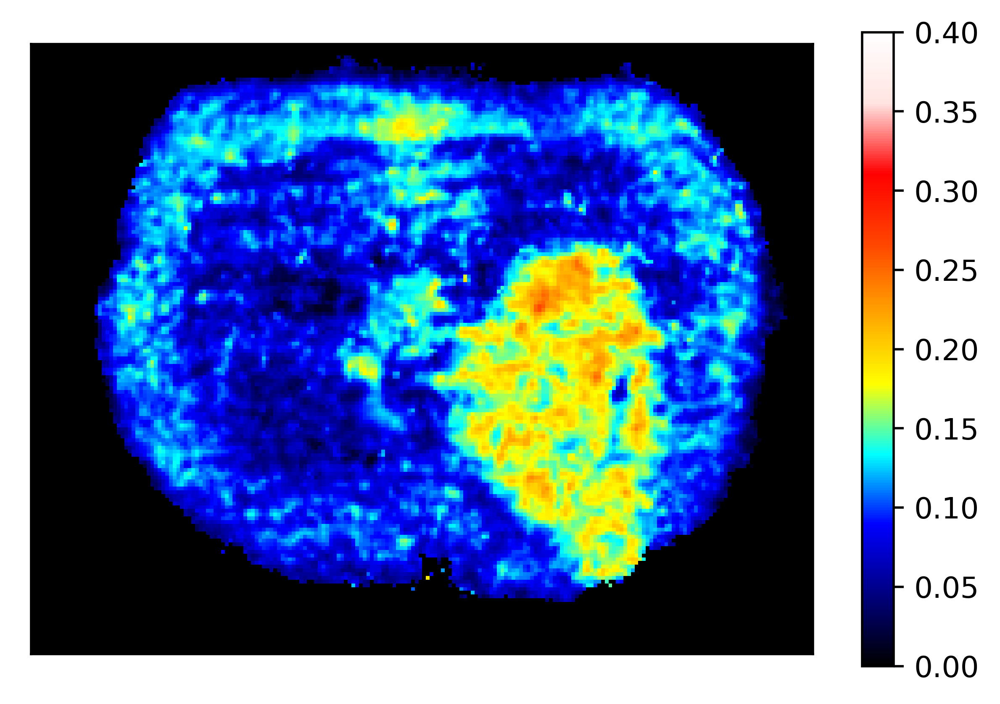

In [19]:
maxLims = {"g":0.3,"d":1.0,"e":1.0,"x0":1.0,"x1":1.0,"x2":1.0,"g+e":.4}
for fn in fluxImages:
    for mol in fluxImages[fn]:
        for val in ["g","d","e","x0","x1","x2","g+e"]:
            if val in fluxImages[fn][mol]:
                img = fluxImages[fn][mol][val]
                plt.figure()
                SIMSIToolBox.showImage(img,cmap = colormap)
                maxLim = maxLims[val]#np.max(img)
                plt.clim(0,maxLim)
                norm = plt.Normalize(vmin=0, vmax=maxLim)
                norm = colormap(norm(img))
                for row in range(norm.shape[0]):
                    for col in range(norm.shape[1]):
                        if msis[fn].imageBoundary[row,col] < .5:
                            norm[row,col,3] = 0
                plt.imsave(datadir + fn.replace(".imzML","/") + mol + "_" + val + ".png",norm)#,cmap=colormap)
                plt.savefig(datadir + fn.replace(".imzML","/") + mol + "_" + val + "_with_colorbar.png")
                

In [9]:
def extractLabelingPattern(data,xmin,xmax,ymin,ymax,badInds=[]):
    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(data[:,x,y])
    roi = np.array(roi)
    
    df  = {}
    aveLabelings = []
    for row in roi:
        for b in badInds:
            row[b] = 0.0
        aveLabelings.append(np.sum([x*row[x] for x in range(len(row))]) / len(row) * np.sum([row[x] for x in range(len(row))]))
        row = row / np.sum(row)
        for x in range(len(row)):
           df[len(df)] = {"isotopologue":"M"+str(x),"Isotopologue Fraction":row[x]}

    df = pd.DataFrame.from_dict(df,orient="index")
    print(np.mean(aveLabelings),np.std(aveLabelings))
    return df

def extractLabelingPatternForStacked(data,xmin,xmax,ymin,ymax):

    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(data[:,x,y])
    roi = np.array(roi)
    
    roi = roi.mean(axis=0)
    
    df  = {}
    for x in range(len(roi)):
       df[len(df)] = {"isotopologue":"M"+str(x),"Isotopologue Fraction":roi[x]}

    df = pd.DataFrame.from_dict(df,orient="index")
    
    df = df.set_index("isotopologue")

    return df

10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C16H32O2 20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.10945802688094798 0.010453109336284254
C16H32O2 20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.08093760237904818 0.012133857070205816
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C16H32O2 20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.09233165592679646 0.009189342091645599
C16H32O2 20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.04510443040156591 0.012033439593310366
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C16H32O2 20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.09017480969631754 0.005458011064326787
C16H32O2 20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.0583612781990056 0.003524037383313123
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C16H32O2 20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML ips
0.10127575024232693 0.010635190391498973


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:102: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


C16H32O2 20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML cont
0.033391962166869515 0.008869187606491967
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C10H14N5O7P 20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.495826012452566 0.03576061948780839
C10H14N5O7P 20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.23331968138935508 0.027435944919479073
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C10H14N5O7P 20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.41365176450155405 0.053020705006195185
C10H14N5O7P 20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.25728286847899556 0.042943879020976135
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C10H14N5O7P 20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.4361505715074318 0.019969394716239333
C10H14N5O7P 20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.2304150324716461 0.01031071254582573
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C10H14N5O7P 20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML ips
0.49385049672853615 0.06405621769189335
C10H14N5O7P 20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML cont
0.3279357298148009 0.06179697411708272
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C18H36O2 20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.08636618925651625 0.008405867527925045
C18H36O2 20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.03886399520513233 0.006388975610218968
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C18H36O2 20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.06508626244083815 0.0073751498678110376
C18H36O2 20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.021425984550158716 0.005229583119751235
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C18H36O2 20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.050470451369337976 0.0043763464338027035
C18H36O2 20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.026755444539012036 0.0014448867675037216
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C18H36O2 20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML ips
0.05736091032337046 0.009378337290143412
C18H36O2 20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML cont
0.01345613055676856 0.0028031722712765082
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C6H9NO5 20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.21749953141179046 0.08778585443658866
C6H9NO5 20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.3115231871123735 0.032394673573125574
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C6H9NO5 20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.26793765885873483 0.13493256107118887
C6H9NO5 20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.27851111962256636 0.040293134551267304
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C6H9NO5 20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML ips
0.15588620869428843 0.050543066782200066
C6H9NO5 20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML cont
0.2850884414062541 0.04217278517997735
10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide


C6H9NO5 20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML ips
0.13885707123394453 0.1066523522048373
C6H9NO5 20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML cont
0.30441989815204534 0.04167285112592854


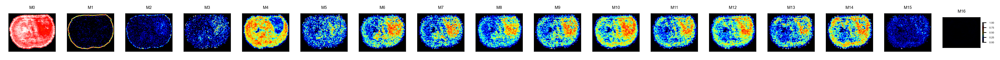

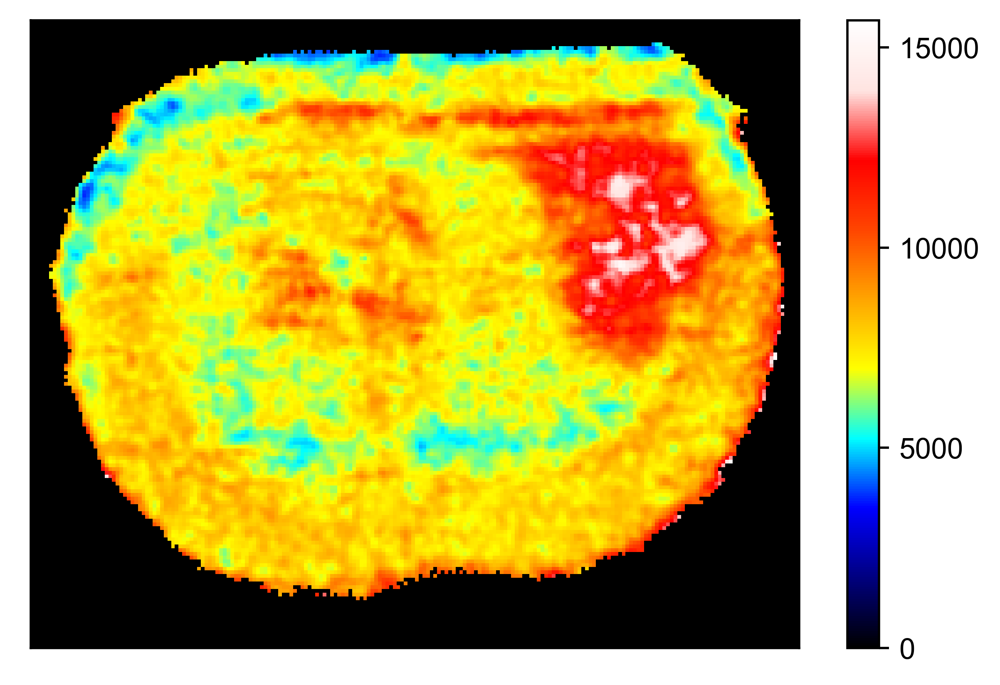

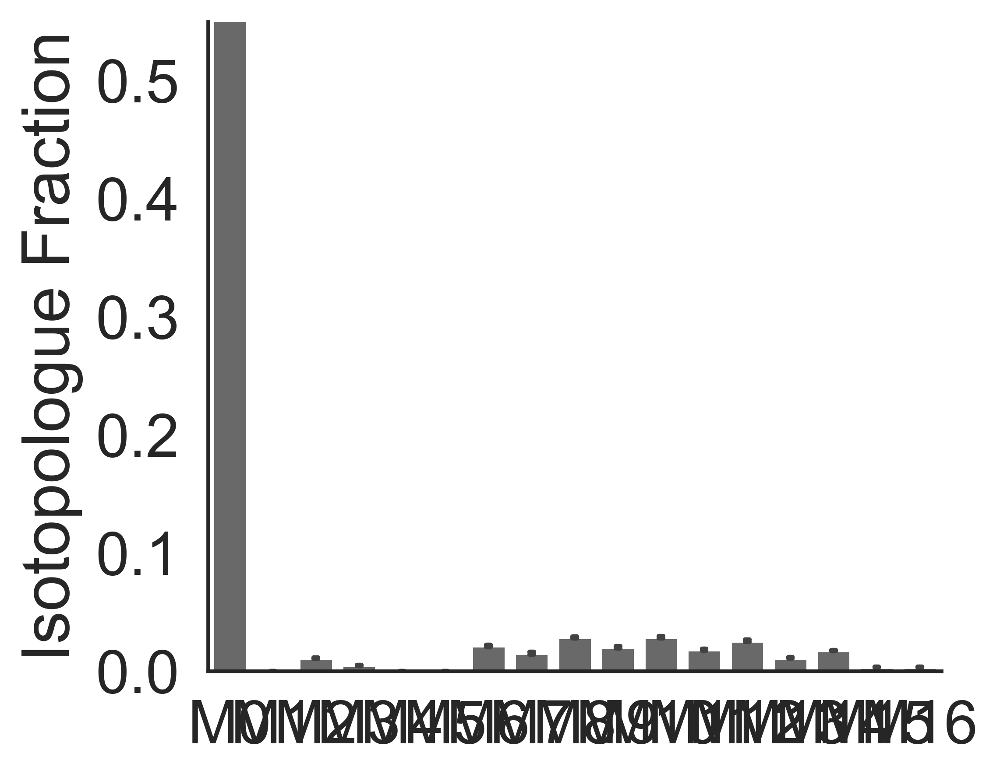

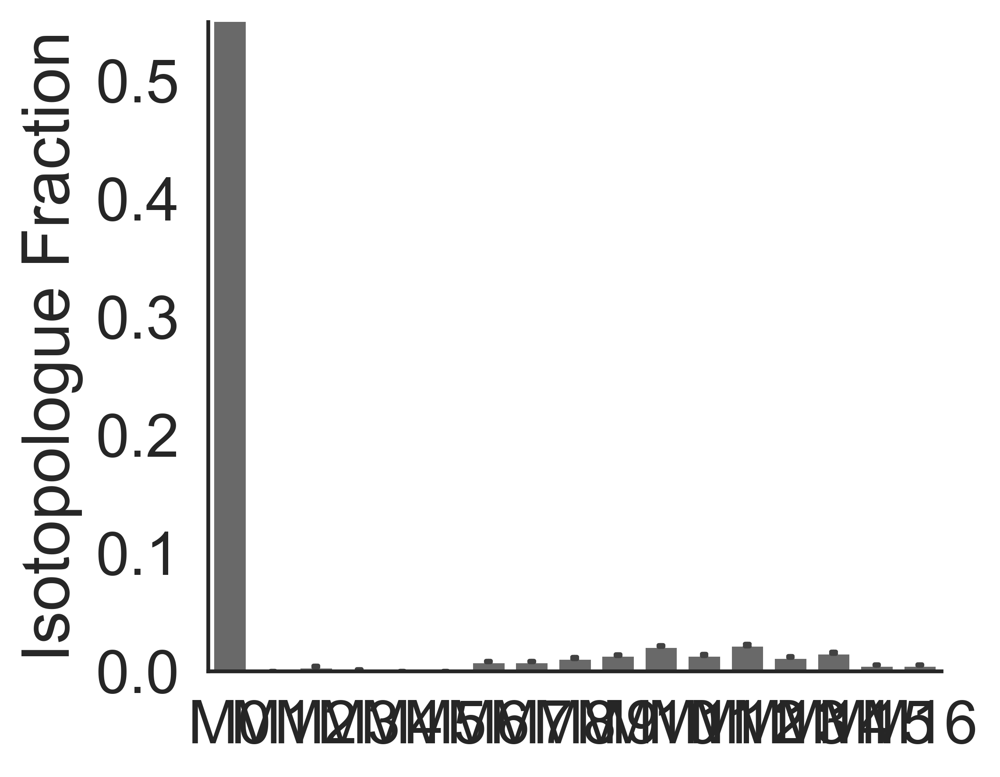

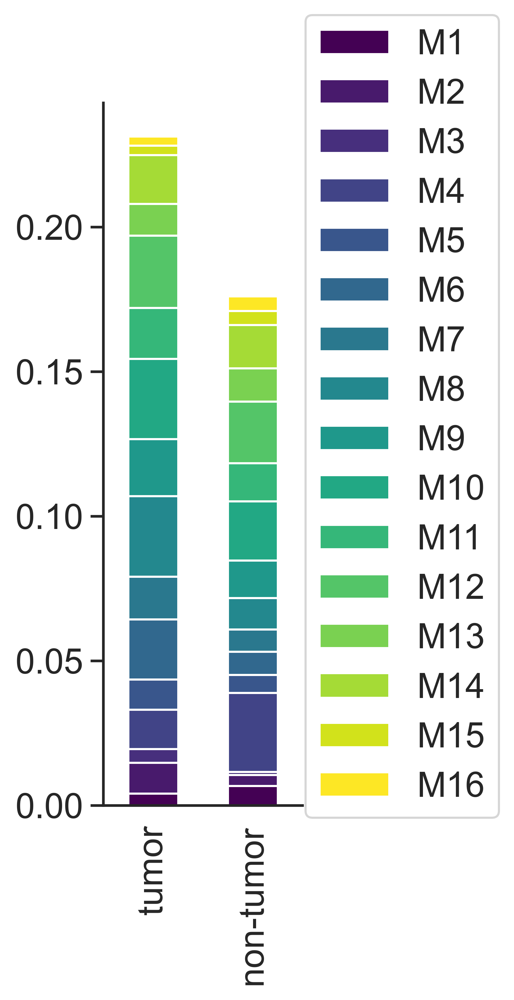

...

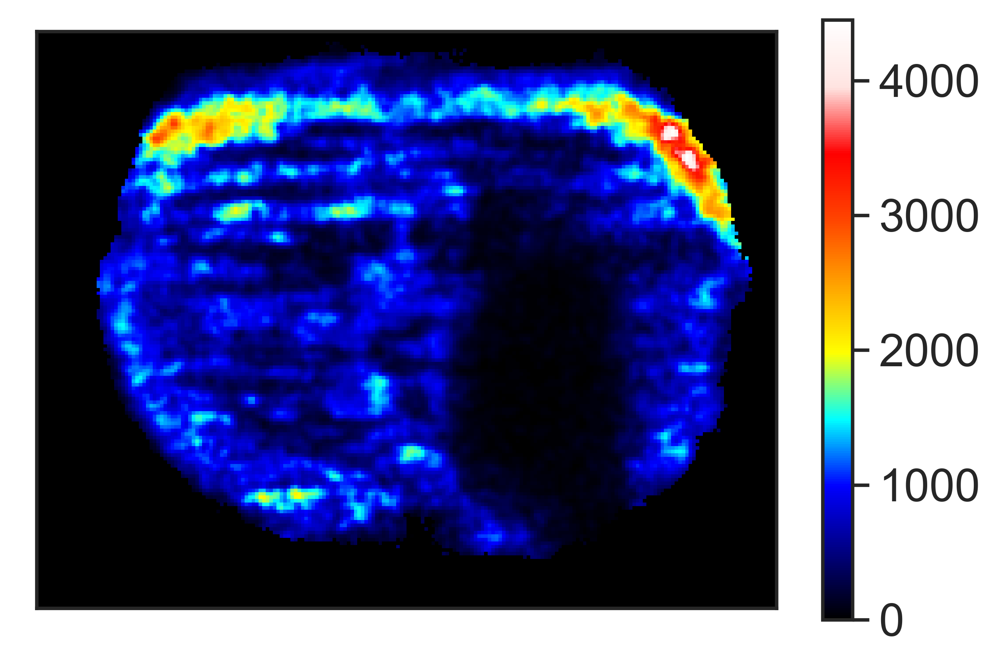

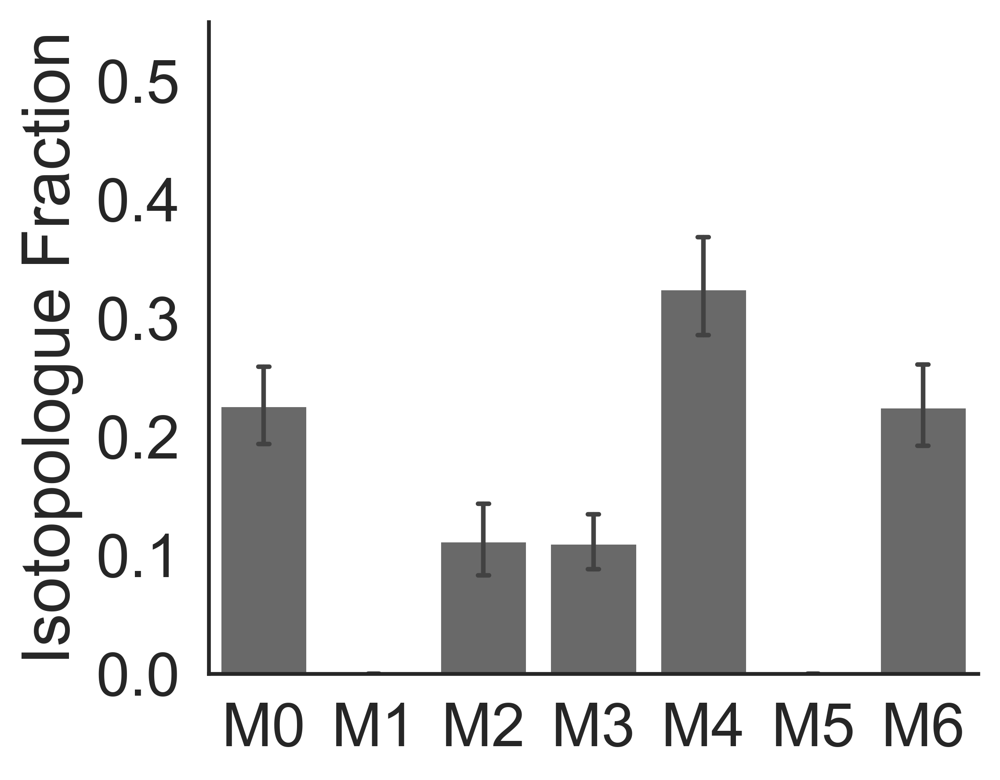

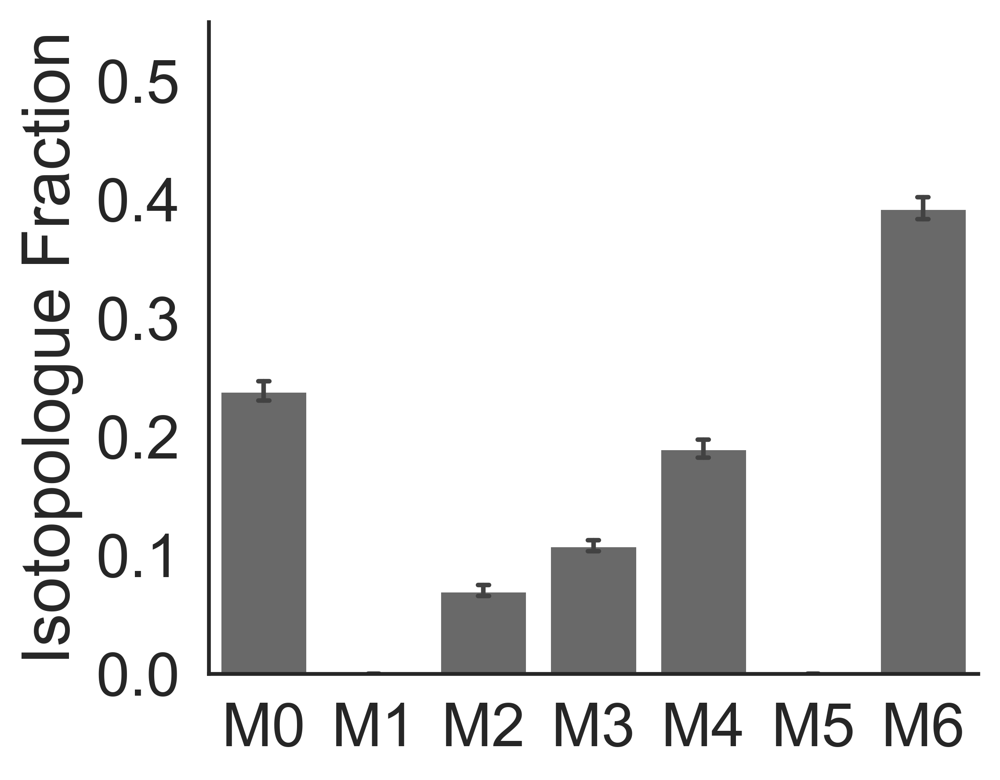

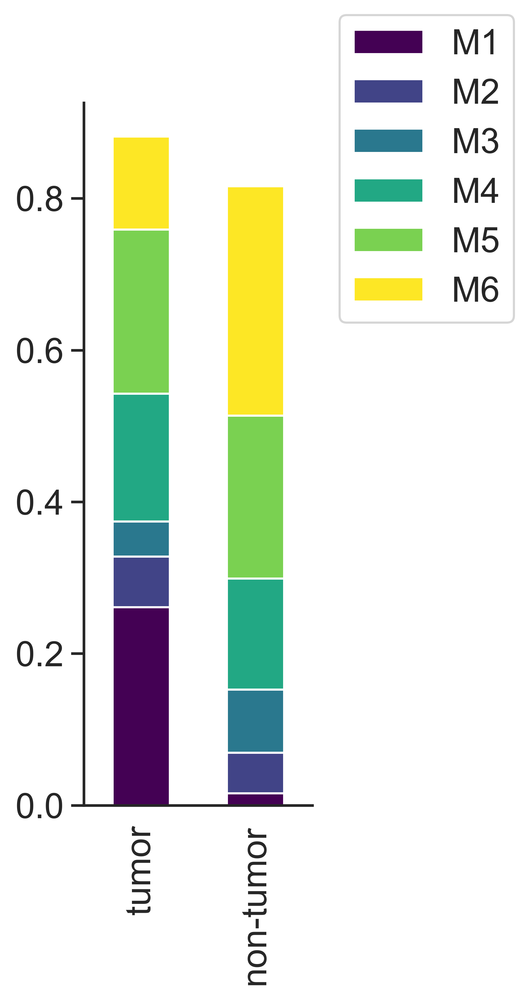

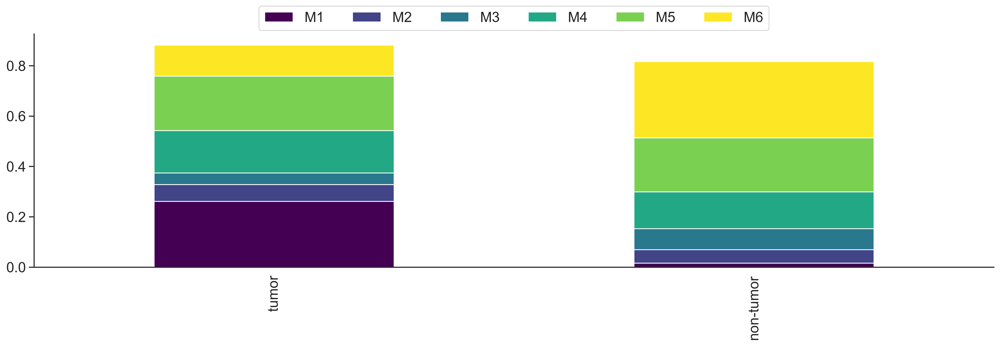

In [10]:
averageLabeling = {fn:{} for fn in msis}
maxLabs = {"C16H32O2":[1.0 for x in range(2)] + [0.1 for x in range(15)],
           "C18H36O2":[1.0 for x in range(2)] + [0.1 for x in range(17)],
           "C6H9NO5":[1.0 for x in range(7)],
           "C10H14N5O7P":[1.0 for x in range(6)] + [0.2 for x in range(5)]}
badInds = {"C16H32O2":[1,4,5],
       "C18H36O2":[17],
       "C6H9NO5":[1,5],
       "C10H14N5O7P":[]}
for index,row2 in peaklist.iterrows():
    if row2["for_paper"] > 0.5:
        inds = row2["inds"]
        for fn in msis:
            print(msis[fn].ppm)
            
            tmpLab = {}
            
            fig, axes = plt.subplots(1,len(inds),figsize=(len(inds),1))
            tmp = msis[fn].data_tensor[inds]
            isoTensor = SIMSIToolBox.normalizeTensor(tmp)
            col = 0
            for img in isoTensor:
                tmp = axes[col].imshow(img,cmap=colormap)
                ave = np.mean(img[msis[fn].imageBoundary > 0.5])
                tmpLab[row2["formula"] + "_M" + str(col)] = ave
                axes[col].set_xticks([])
                axes[col].set_yticks([])
                axes[col].set_title("M"+str(col),fontsize=5)
                if col == len(isoTensor) - 1:
                    cbar = plt.colorbar(tmp, ax=axes[col],shrink=0.5)
                    tmp.set_clim(0.0,1.0)
                    cbar.ax.tick_params(labelsize=3)
                col += 1
            
            plt.tight_layout()
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_iso_all.png")

            tmp = msis[fn].data_tensor[inds]
            isoTensor = SIMSIToolBox.normalizeTensor(tmp)
            maxLim = 1.0
            counter = 0
            for img in isoTensor:
                norm = plt.Normalize(vmin=0, vmax=maxLabs[row2["formula"]][counter])
                norm = colormap(norm(img))
                for row in range(norm.shape[0]):
                    for col in range(norm.shape[1]):
                        if msis[fn].imageBoundary[row,col] < .5:
                            norm[row,col,3] = 0
                plt.imsave(datadir + fn.replace(".imzML","/") + row2["formula"] + "_M" + str(counter) +".png",norm)#,cmap=colormap)
                counter += 1
            
            plt.figure()
            SIMSIToolBox.showImage(img,cmap = colormap)
            plt.clim(0,maxLabs[row2["formula"]][counter-1])
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_M" + str(counter-1) +"_withColorBar.png")
            plt.close()

            
            #[inds[x] for x in range(len(inds)) if x not in badInds[row2["formula"]]]
            #tmp = msis[fn].data_tensor[inds[x] for x in range(len(inds)) if x not in badInds[row2["formula"]]]
            tmp = msis[fn].data_tensor[[inds[x] for x in range(len(inds)) if x not in badInds[row2["formula"]]]]
            poolSize = np.sum(tmp,axis=0)
            meanInt = np.mean(msis[fn].tic_image[msis[fn].imageBoundary > 0.5])
            poolSize = poolSize / msis[fn].tic_image
            poolSize = poolSize * meanInt
            poolSize[msis[fn].imageBoundary < 0.5] = 0.0
            plt.figure()
            
            SIMSIToolBox.showImage(poolSize,cmap = colormap)
            maxLim = np.max(poolSize)
            plt.clim(0,maxLim)
            norm = plt.Normalize(vmin=0, vmax=maxLim)
            norm = colormap(norm(poolSize))
            for row in range(norm.shape[0]):
                for col in range(norm.shape[1]):
                    if msis[fn].imageBoundary[row,col] < .5:
                        norm[row,col,3] = 0
            plt.imsave(datadir + fn.replace(".imzML","/") + row2["formula"] + "_pool.png",norm)#,cmap=colormap)
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_pool_with_colorbar.png")

            box1 = boxBoundaries[fn]["i"]
            box2 = boxBoundaries[fn]["c"]
                    
            norm = addBox(*box1[1],*box1[0],(1.0,0,0,1.0),norm)
            norm = addBox(*box2[1],*box2[0],(1.0,0,0,1.0),norm)

            plt.imsave(datadir + fn.replace(".imzML","/") + row2["formula"] + "_boxed_pool.png",norm)#,cmap=colormap)

            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_pool_with_colorbar.png")

            sb.set_theme(style="white",font_scale=1.8)

            print(row2["formula"],fn,"ips")
            df = extractLabelingPattern(isoTensor,*box1[1],*box1[0],badInds[row2["formula"]])
            
            #for x in badInds[row2["formula"]]:
            #    toAdjust = [index for index in df.index.values if df.at[index,"isotopologue"] == "M" + str(x)]
            #    df.loc[toAdjust,"Isotopologue Fraction"] = 0.0
            
            maxLabeling = 1.0

            fig,ax = plt.subplots(figsize=(5,4))

            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)

            sb.barplot(data=df,x="isotopologue",y="Isotopologue Fraction",capsize=.1,color="dimgrey",errwidth=1.5)
            plt.ylim((0,0.55))
            plt.xlabel("")
            plt.tight_layout()
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_box1_labeling_bar.png")

            fig,ax = plt.subplots(figsize=(5,4))
            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)
            
            print(row2["formula"],fn,"cont")
            df2 = extractLabelingPattern(isoTensor,*box2[1],*box2[0],badInds[row2["formula"]])
            
            #for x in badInds[row2["formula"]]:
            #    toAdjust = [index for index in df2.index.values if df.at[index,"isotopologue"] == "M" + str(x)]
            #    df2.loc[toAdjust,"Isotopologue Fraction"] = 0.0

            sb.barplot(data=df2,x="isotopologue",y="Isotopologue Fraction",capsize=.1,color="dimgrey",errwidth=1.5)
            plt.ylim((0,0.55))
            plt.xlabel("")
            plt.tight_layout()
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_box2_labeling_bar.png")

            sb.set_theme(font_scale=1.5,style={'ytick.left': True})

            fig,ax = plt.subplots(figsize=(5,7))

            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)

            df = extractLabelingPatternForStacked(isoTensor,*box1[1],*box1[0])
            df = df.rename(mapper={"Isotopologue Fraction":"tumor"},axis=1)

            df2 = extractLabelingPatternForStacked(isoTensor,*box2[1],*box2[0])
            df2 = df2.rename(mapper={"Isotopologue Fraction":"non-tumor"},axis=1)

            df = pd.concat((df,df2),axis=1,ignore_index=False).transpose()

            df = df[[x for x in df.columns.values if x != "M0"]]

            df.plot(kind='bar', stacked=True,ax=ax,cmap="viridis")

            plt.legend(loc="upper center", bbox_to_anchor=(1.5, 1.15) )

            #plt.yticks([0.0,0.05,0.1,0.15,0.2,0.25,0.30],rotation=90)

            plt.tight_layout()

            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_labeling_stacked.png")

            fig,ax = plt.subplots(figsize=(20,5))

            df.plot(kind='bar', stacked=True,ax=ax,cmap="viridis")

            plt.legend(loc="upper center", bbox_to_anchor=(.5, 1.15) ,ncol=len(df.columns))

            #plt.colorbar()

            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)

            plt.savefig(datadir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_labeling_stacked_legend.png")


            for key,val in tmpLab.items():
                averageLabeling[fn][key] = np.mean(val)
    
    

In [25]:
pkl.dump([peaklist,msis,fluxImages],open(datadir + "processed_data.pkl","wb"))

In [7]:
[peaklist,msis,fluxImages] = pkl.load(open(datadir + "processed_data.pkl","rb"))

In [23]:
averageLabeling = pd.DataFrame.from_dict(averageLabeling,orient="index")
averageLabeling

,C16H32O2_M0,C16H32O2_M1,C16H32O2_M2,C16H32O2_M3,C16H32O2_M4,C16H32O2_M5,C16H32O2_M6,C16H32O2_M7,C16H32O2_M8,C16H32O2_M9,...,C18H36O2_M16,C18H36O2_M17,C18H36O2_M18,C6H9NO5_M0,C6H9NO5_M1,C6H9NO5_M2,C6H9NO5_M3,C6H9NO5_M4,C6H9NO5_M5,C6H9NO5_M6
20221107_mt_tumor_brain4-4_13B_13C_20um_70-560mz Analyte 1_1_recal.imzML,0.820752,0.005202,0.004910,0.002516,0.024685,0.007805,0.012430,0.009648,0.017237,0.012825,...,0.003908,0.001001,0.001096,0.155715,0.031702,0.059899,0.098317,0.184828,0.222728,0.246811
20221109_mt_tumor_brain4-2_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML,0.824936,0.017287,0.011955,0.006522,0.026369,0.009077,0.012476,0.008459,0.014081,0.009456,...,0.002950,0.000819,0.000900,0.179501,0.050105,0.079074,0.114160,0.173744,0.191359,0.212058
20221111_mt_tumor_brain4-1_10L_13C_20um_70-560mz Analyte 1_1_recal.imzML,0.838514,0.018762,0.004173,0.002296,0.020028,0.005593,0.010495,0.007843,0.015822,0.010819,...,0.002735,0.000694,0.000778,0.159149,0.022029,0.055232,0.104337,0.188945,0.220933,0.249375
20221116_mt_tumor_brain4-3_12L_13C_20um_70-560mz Analyte 2_1_recal.imzML,0.861281,0.007522,0.004603,0.001500,0.014860,0.004585,0.007600,0.006303,0.013260,0.009286,...,0.003571,0.000996,0.001156,0.155890,0.029431,0.048736,0.079901,0.170227,0.227481,0.288329


In [24]:
averageLabeling.to_csv(datadir + "average_labeling.csv")